Loading: C:\Users\saurav\Downloads\SEVI_Nepal_Project\data\geo\nepal.geojson
Loading: C:\Users\saurav\Downloads\SEVI_Nepal_Project\data\final\province_analysis_results\province_level_statistics.csv

GeoJSON Loaded:
   Province     TARGET  Level         DISTRICT  \
0         1  Province1      0     प्रदेश नं. १   
1         2  Province2      0     प्रदेश नं. २   
2         3  Province3      0    बागमती प्रदेश   
3         4  Province4      0    गण्डकी प्रदेश   
4         5  Province5      0  लुम्बिनी प्रदेश   

                                            geometry  
0  POLYGON ((86.90409 26.48835, 86.90634 26.49041...  
1  POLYGON ((84.56527 27.46316, 84.56679 27.46152...  
2  POLYGON ((86.51557 27.95662, 86.51822 27.9532,...  
3  POLYGON ((85.10796 28.3466, 85.10312 28.34556,...  
4  POLYGON ((82.67263 28.85226, 82.67373 28.85205...  
Columns: Index(['Province', 'TARGET', 'Level', 'DISTRICT', 'geometry'], dtype='object')

CSV Loaded:
  PROVINCE  VULN_MEAN  VULN_STD  VULN_MIN  VULN_MAX  

<Figure size 1200x1000 with 0 Axes>

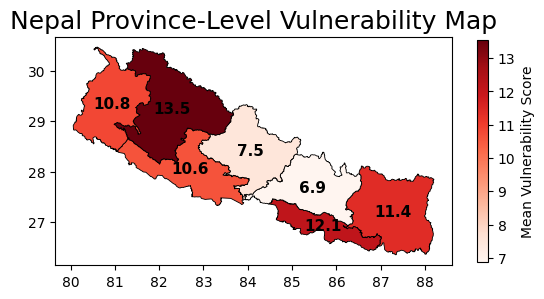


STATIC MAP WITH VALUES DISPLAYED

CREATING COMPARATIVE VULNERABILITY MAPS
Available columns in merged data: ['Province', 'TARGET', 'Level', 'DISTRICT', 'geometry', 'province_name', 'province_clean', 'PROVINCE', 'VULN_MEAN', 'VULN_STD', 'VULN_MIN', 'VULN_MAX', 'DISTRICT_COUNT', 'HOUSING_VULN_MEAN', 'WATER_VULN_MEAN', 'SANITATION_VULN_MEAN', 'DOMINANT_CLUSTER']


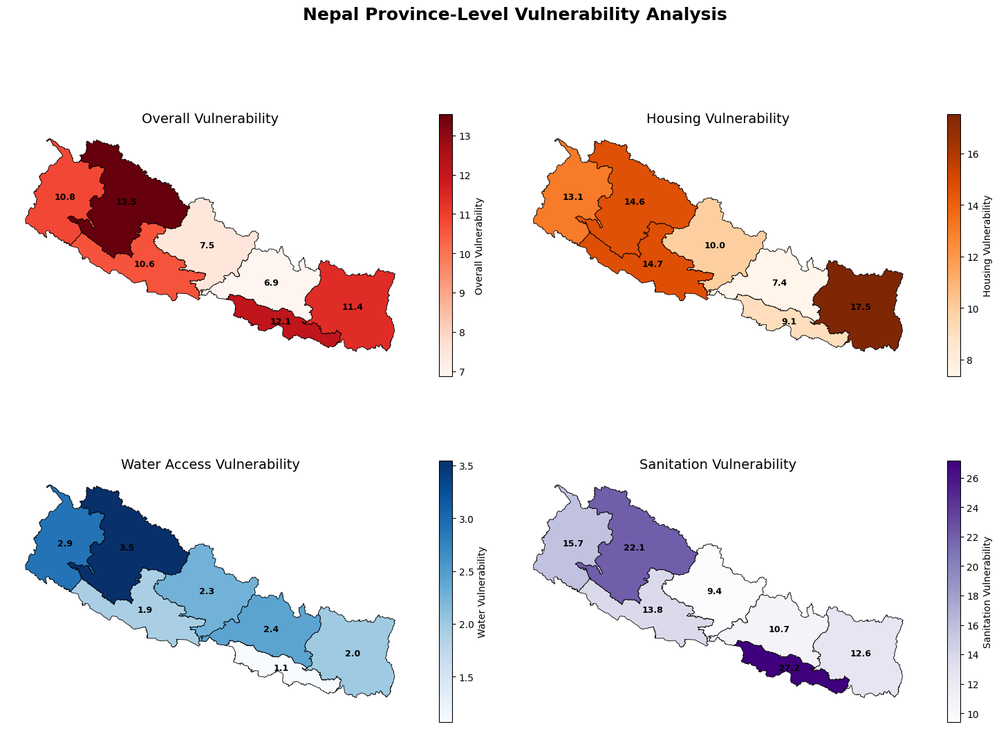

COMPARATIVE STATIC MAPS CREATED

CREATING INTERACTIVE DASHBOARD

Available metrics for interactive map: ['VULN_MEAN', 'HOUSING_VULN_MEAN', 'WATER_VULN_MEAN', 'SANITATION_VULN_MEAN', 'VULN_STD']

Option 2: Individual Metric Maps



Option 3: Province Comparison Bar Chart



PROVINCE VULNERABILITY COMPARISON

Province Vulnerability Comparison Table:
------------------------------------------------------------------------------------------
    Province Overall Rank Housing Water Sanitation  Districts  Cluster
       Koshi    11.4   #3    17.5   2.0       12.6         10        1
     Madhesh    12.1   #2     9.1   1.1       27.2         12        2
     Bagmati     6.9   #7     7.4   2.4       10.7         13        1
     Gandaki     7.5   #6    10.0   2.3        9.4          8        1
     Lumbini    10.6   #5    14.7   1.9       13.8         10        1
     Karnali    13.5   #1    14.6   3.5       22.1         17        1
Sudurpaschim    10.8   #4    13.1   2.9       15.7          7        1

VULNERABILITY SUMMARY STATISTICS

Overall Vulnerability Range: 6.9 - 13.5
Average: 10.4

Most Vulnerable Province: Karnali (Score: 13.5)
Least Vulnerable Province: Bagmati (Score: 6.9)

Housing Vulnerability Range: 7.4 - 17.5
Water Vulnerability Range: 1.1 - 3.5


In [2]:
# =====================================================================
# NEPAL PROVINCE MAP – FINAL FULL VERSION (STATIC + INTERACTIVE)
# =====================================================================

import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import json
import os

# =====================================================================
# 1. PATHS
# =====================================================================

BASE_DIR = r"C:\Users\saurav\Downloads\SEVI_Nepal_Project\data"
GEO_PATH = os.path.join(BASE_DIR, "geo", "nepal.geojson")   
CSV_PATH = os.path.join(BASE_DIR, "final", "province_analysis_results", "province_level_statistics.csv")

print("Loading:", GEO_PATH)
print("Loading:", CSV_PATH)

# =====================================================================
# 2. LOAD PROVINCE MAP
# =====================================================================

if not os.path.exists(GEO_PATH):
    raise FileNotFoundError("Province-level geojson not found")

gdf = gpd.read_file(GEO_PATH)

print("\nGeoJSON Loaded:")
print(gdf.head())
print("Columns:", gdf.columns)

# =====================================================================
# 3. FIX: Province column (1–7) → Province Names
# =====================================================================

province_map = {
    1: "Koshi",
    2: "Madhesh",
    3: "Bagmati",
    4: "Gandaki",
    5: "Lumbini",
    6: "Karnali",
    7: "Sudurpaschim"
}

# Add readable province name column
gdf["province_name"] = gdf["Province"].map(province_map)

# Clean province name for merging
gdf["province_clean"] = (
    gdf["province_name"]
    .astype(str)
    .str.strip()
    .str.lower()
)

# =====================================================================
# 4. LOAD CSV DATA
# =====================================================================

df = pd.read_csv(CSV_PATH)

df["province_clean"] = (
    df["PROVINCE"]
    .astype(str)
    .str.strip()
    .str.lower()
)

print("\nCSV Loaded:")
print(df.head())
print("\nCSV Columns:", df.columns.tolist())

# =====================================================================
# 5. MERGE GEOJSON + CSV
# =====================================================================

merged = gdf.merge(df, on="province_clean", how="left")

print("\nMerged Data:")
print(merged[["province_name", "VULN_MEAN", "HOUSING_VULN_MEAN", "WATER_VULN_MEAN", "SANITATION_VULN_MEAN"]].head())

# =====================================================================
# 6. STATIC MAP WITH VALUES SHOWN INSIDE PROVINCES
# =====================================================================

plt.figure(figsize=(12, 10))

ax = merged.plot(
    column="VULN_MEAN",
    cmap="Reds",
    edgecolor="black",
    linewidth=0.6,
    legend=True,
    legend_kwds={"label": "Mean Vulnerability Score", "shrink": 0.6}
)

plt.title("Nepal Province-Level Vulnerability Map", fontsize=18)

# ---- ADD LABELS AT CENTROIDS ----
for idx, row in merged.iterrows():
    centroid = row.geometry.centroid
    value = row["VULN_MEAN"]

    label = f"{value:.1f}" if pd.notna(value) else "N/A"

    plt.text(
        centroid.x,
        centroid.y,
        label,
        fontsize=11,
        ha="center",
        va="center",
        color="black",
        weight="bold"
    )

plt.show()
print("\nSTATIC MAP WITH VALUES DISPLAYED")

# =====================================================================
# 7. ENHANCED STATIC MAPS - MULTIPLE VULNERABILITY METRICS
# =====================================================================

print("\n" + "="*60)
print("CREATING COMPARATIVE VULNERABILITY MAPS")
print("="*60)

# Check which columns are available
available_columns = merged.columns.tolist()
print("Available columns in merged data:", available_columns)

# Create subplots for different vulnerability metrics
fig, axes = plt.subplots(2, 2, figsize=(15, 12))
fig.suptitle('Nepal Province-Level Vulnerability Analysis', fontsize=18, fontweight='bold')

# Plot 1: Overall Vulnerability
ax1 = axes[0, 0]
if 'VULN_MEAN' in merged.columns:
    merged.plot(
        column="VULN_MEAN",
        cmap="Reds",
        edgecolor="black",
        linewidth=0.6,
        legend=True,
        legend_kwds={"label": "Overall Vulnerability", "shrink": 0.6},
        ax=ax1
    )
    for idx, row in merged.iterrows():
        centroid = row.geometry.centroid
        ax1.text(centroid.x, centroid.y, f"{row['VULN_MEAN']:.1f}", 
                 fontsize=9, ha='center', va='center', fontweight='bold')
    ax1.set_title("Overall Vulnerability", fontsize=14)
else:
    ax1.text(0.5, 0.5, "VULN_MEAN not available", ha='center', va='center')
ax1.axis('off')

# Plot 2: Housing Vulnerability
ax2 = axes[0, 1]
if 'HOUSING_VULN_MEAN' in merged.columns:
    merged.plot(
        column="HOUSING_VULN_MEAN",
        cmap="Oranges",
        edgecolor="black",
        linewidth=0.6,
        legend=True,
        legend_kwds={"label": "Housing Vulnerability", "shrink": 0.6},
        ax=ax2
    )
    for idx, row in merged.iterrows():
        centroid = row.geometry.centroid
        ax2.text(centroid.x, centroid.y, f"{row['HOUSING_VULN_MEAN']:.1f}", 
                 fontsize=9, ha='center', va='center', fontweight='bold')
    ax2.set_title("Housing Vulnerability", fontsize=14)
else:
    ax2.text(0.5, 0.5, "HOUSING_VULN_MEAN not available", ha='center', va='center')
ax2.axis('off')

# Plot 3: Water Vulnerability
ax3 = axes[1, 0]
if 'WATER_VULN_MEAN' in merged.columns:
    merged.plot(
        column="WATER_VULN_MEAN",
        cmap="Blues",
        edgecolor="black",
        linewidth=0.6,
        legend=True,
        legend_kwds={"label": "Water Vulnerability", "shrink": 0.6},
        ax=ax3
    )
    for idx, row in merged.iterrows():
        centroid = row.geometry.centroid
        ax3.text(centroid.x, centroid.y, f"{row['WATER_VULN_MEAN']:.1f}", 
                 fontsize=9, ha='center', va='center', fontweight='bold')
    ax3.set_title("Water Access Vulnerability", fontsize=14)
else:
    ax3.text(0.5, 0.5, "WATER_VULN_MEAN not available", ha='center', va='center')
ax3.axis('off')

# Plot 4: Sanitation Vulnerability
ax4 = axes[1, 1]
if 'SANITATION_VULN_MEAN' in merged.columns:
    merged.plot(
        column="SANITATION_VULN_MEAN",
        cmap="Purples",
        edgecolor="black",
        linewidth=0.6,
        legend=True,
        legend_kwds={"label": "Sanitation Vulnerability", "shrink": 0.6},
        ax=ax4
    )
    for idx, row in merged.iterrows():
        centroid = row.geometry.centroid
        ax4.text(centroid.x, centroid.y, f"{row['SANITATION_VULN_MEAN']:.1f}", 
                 fontsize=9, ha='center', va='center', fontweight='bold')
    ax4.set_title("Sanitation Vulnerability", fontsize=14)
else:
    ax4.text(0.5, 0.5, "SANITATION_VULN_MEAN not available", ha='center', va='center')
ax4.axis('off')

plt.tight_layout()
plt.show()
print("COMPARATIVE STATIC MAPS CREATED")

# =====================================================================
# 8. INTERACTIVE DASHBOARD
# =====================================================================

print("\n" + "="*60)
print("CREATING INTERACTIVE DASHBOARD")
print("="*60)

merged_json = json.loads(merged.to_json())

# Get available metrics
available_metrics = []
metric_titles = {
    'VULN_MEAN': 'Overall Vulnerability',
    'HOUSING_VULN_MEAN': 'Housing Vulnerability',
    'WATER_VULN_MEAN': 'Water Access Vulnerability',
    'SANITATION_VULN_MEAN': 'Sanitation Vulnerability',
    'VULN_STD': 'Vulnerability Variability'
}

for metric in metric_titles.keys():
    if metric in merged.columns:
        available_metrics.append(metric)

print(f"\nAvailable metrics for interactive map: {available_metrics}")

if available_metrics:
    # Option 2: SEPARATE MAPS FOR KEY METRICS
    print("\nOption 2: Individual Metric Maps")
    
    key_metrics = ['VULN_MEAN', 'HOUSING_VULN_MEAN', 'WATER_VULN_MEAN']
    colors = ['Reds', 'Oranges', 'Blues']
    
    for metric, color in zip(key_metrics, colors):
        if metric in merged.columns:
            fig = px.choropleth_map(
                merged,
                geojson=merged_json,
                locations=merged.index,
                color=metric,
                hover_name="province_name",
                hover_data={
                    "VULN_MEAN": ":.1f",
                    "HOUSING_VULN_MEAN": ":.1f",
                    "WATER_VULN_MEAN": ":.1f",
                    "SANITATION_VULN_MEAN": ":.1f",
                    "DISTRICT_COUNT": True,
                    "DOMINANT_CLUSTER": True
                },
                map_style="carto-positron",
                center={"lat": 28.3, "lon": 84},
                zoom=5,
                opacity=0.8,
                color_continuous_scale=color,
                title=f"<b>{metric_titles[metric]} - Nepal Provinces</b>"
            )
            
            fig.update_layout(
                height=600,
                margin={"r":0,"t":50,"l":0,"b":0}
            )
            
            fig.show()
    
    # Option 3: PROVINCE COMPARISON BAR CHART
    print("\nOption 3: Province Comparison Bar Chart")
    
    fig = px.bar(
        merged.sort_values('VULN_MEAN', ascending=True),
        x='VULN_MEAN',
        y='province_name',
        orientation='h',
        color='VULN_MEAN',
        color_continuous_scale='Reds',
        text='VULN_MEAN',
        title='<b>Province Vulnerability Ranking</b>'
    )
    
    fig.update_traces(texttemplate='%{x:.1f}', textposition='outside')
    fig.update_layout(
        xaxis_title="Vulnerability Score",
        yaxis_title="Province",
        height=500,
        width=800,
        showlegend=False
    )
    
    fig.show()

# =====================================================================
# 9. PROVINCE COMPARISON TABLE
# =====================================================================

print("\n" + "="*60)
print("PROVINCE VULNERABILITY COMPARISON")
print("="*60)

# Create a comparison table with fixed rank calculation
comparison_data = []

# Calculate ranks properly
merged['overall_rank'] = merged['VULN_MEAN'].rank(method='dense', ascending=False).astype(int)

for _, row in merged.iterrows():
    comparison_data.append([
        row['province_name'],
        f"{row['VULN_MEAN']:.1f}",
        f"#{row['overall_rank']}",
        f"{row['HOUSING_VULN_MEAN']:.1f}" if 'HOUSING_VULN_MEAN' in row and pd.notna(row['HOUSING_VULN_MEAN']) else "N/A",
        f"{row['WATER_VULN_MEAN']:.1f}" if 'WATER_VULN_MEAN' in row and pd.notna(row['WATER_VULN_MEAN']) else "N/A",
        f"{row['SANITATION_VULN_MEAN']:.1f}" if 'SANITATION_VULN_MEAN' in row and pd.notna(row['SANITATION_VULN_MEAN']) else "N/A",
        row['DISTRICT_COUNT'] if 'DISTRICT_COUNT' in row and pd.notna(row['DISTRICT_COUNT']) else "N/A",
        row.get('DOMINANT_CLUSTER', 'N/A')
    ])

# Create DataFrame for nice display
comparison_df = pd.DataFrame(
    comparison_data,
    columns=['Province', 'Overall', 'Rank', 'Housing', 'Water', 'Sanitation', 'Districts', 'Cluster']
)

print("\nProvince Vulnerability Comparison Table:")
print("-" * 90)
print(comparison_df.to_string(index=False))

# =====================================================================
# 10. SUMMARY STATISTICS
# =====================================================================

print("\n" + "="*60)
print("VULNERABILITY SUMMARY STATISTICS")
print("="*60)

if 'VULN_MEAN' in merged.columns:
    print(f"\nOverall Vulnerability Range: {merged['VULN_MEAN'].min():.1f} - {merged['VULN_MEAN'].max():.1f}")
    print(f"Average: {merged['VULN_MEAN'].mean():.1f}")
    
    # Find most and least vulnerable provinces
    most_vulnerable_idx = merged['VULN_MEAN'].idxmax()
    least_vulnerable_idx = merged['VULN_MEAN'].idxmin()
    
    most_vulnerable = merged.loc[most_vulnerable_idx]
    least_vulnerable = merged.loc[least_vulnerable_idx]
    
    print(f"\nMost Vulnerable Province: {most_vulnerable['province_name']} (Score: {most_vulnerable['VULN_MEAN']:.1f})")
    print(f"Least Vulnerable Province: {least_vulnerable['province_name']} (Score: {least_vulnerable['VULN_MEAN']:.1f})")

if 'HOUSING_VULN_MEAN' in merged.columns:
    print(f"\nHousing Vulnerability Range: {merged['HOUSING_VULN_MEAN'].min():.1f} - {merged['HOUSING_VULN_MEAN'].max():.1f}")

if 'WATER_VULN_MEAN' in merged.columns:
    print(f"Water Vulnerability Range: {merged['WATER_VULN_MEAN'].min():.1f} - {merged['WATER_VULN_MEAN'].max():.1f}")

if 'SANITATION_VULN_MEAN' in merged.columns:
    print(f"Sanitation Vulnerability Range: {merged['SANITATION_VULN_MEAN'].min():.1f} - {merged['SANITATION_VULN_MEAN'].max():.1f}")

# =====================================================================
# 11. DATA EXPORT
# =====================================================================

print("\n" + "="*60)
print("EXPORTING RESULTS")
print("="*60)

# Save the merged data for future use
output_path = os.path.join(BASE_DIR, "final", "province_analysis_results", "province_map_data.geojson")
merged.to_file(output_path, driver='GeoJSON')
print(f"Map data saved to: {output_path}")

# Save comparison table
table_output = os.path.join(BASE_DIR, "final", "province_analysis_results", "province_comparison_table.csv")
comparison_df.to_csv(table_output, index=False)
print(f"Comparison table saved to: {table_output}")

print("\n" + "="*60)
print("ALL VISUALIZATIONS COMPLETED SUCCESSFULLY!")
print("="*60)